## 8. Review and discussion of midterm project

In this notebook, we will analyse and visualise the temporal mobility network in the city across the 24 hours of a typical day.


<img src="Yerevan_PageRank.gif" width="1000" align="center">

### Temporal mobility network analysis

In [1]:
# import necessary libraries

#%install_ext https://raw.github.com/cpcloud/ipython-autotime/master/autotime.py
%load_ext autotime
import osmnx as ox, geopandas as gpd, pandas as pd, networkx as nx
import numpy as np
import matplotlib.pyplot as plt
from shapely.geometry import Point, LineString, Polygon, MultiPolygon
from IPython.display import Image
from descartes import PolygonPatch
from itertools import combinations, combinations_with_replacement
%matplotlib inline
ox.config(log_console=True, use_cache=True)
%config IPCompleter.greedy=True

In [2]:
# load the temporal OD dataframe we built in the previous notebook
data = pd.read_csv('../data/Yerevan_hourly_rides.csv', index_col=0, header=0)

# add new column with total daily flow by summing across all columns
time_cols = [c for c in data.columns if c.lower()[:4] == 'time']
data_flows = data.drop(time_cols, axis=1)
hour_cols = data_flows.columns.to_series().apply(lambda x: x.startswith('hour_' ))

hour_all = data_flows.loc[:,hour_cols].sum(1)
data_flows['total_flow'] = hour_all
data_flows.head()

C:\Users\gevor\anaconda3\lib\site-packages\numpy\lib\arraysetops.py:580: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


,origins,destinations,hour_1,hour_2,hour_3,hour_4,hour_5,hour_6,hour_7,hour_8,...,hour_16,hour_17,hour_18,hour_19,hour_20,hour_21,hour_22,hour_23,hour_24,total_flow
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,2,2
1,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,2,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,3,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,4,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [3]:
# filter out only positive flows
flows_pos = data_flows[data_flows.total_flow>0]
flows_pos.head()

,origins,destinations,hour_1,hour_2,hour_3,hour_4,hour_5,hour_6,hour_7,hour_8,...,hour_16,hour_17,hour_18,hour_19,hour_20,hour_21,hour_22,hour_23,hour_24,total_flow
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,2,2
46,0,46,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,1
69,0,69,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,1
70,0,70,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,1
71,0,71,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,1


In [4]:
flows_pos.index = np.arange(len(flows_pos))
flows_pos.tail()

,origins,destinations,hour_1,hour_2,hour_3,hour_4,hour_5,hour_6,hour_7,hour_8,...,hour_16,hour_17,hour_18,hour_19,hour_20,hour_21,hour_22,hour_23,hour_24,total_flow
51422,1297,1203,0,2,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,3
51423,1297,1204,0,2,0,0,0,1,0,0,...,1,1,0,1,1,1,1,0,0,11
51424,1297,1205,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,2
51425,1297,1222,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
51426,1297,1239,0,0,1,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,2


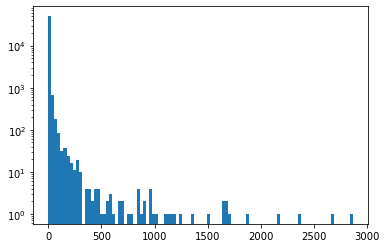

In [5]:
# quick histogram of total flows
plt.hist(flows_pos.total_flow, bins=100, log=True)
plt.show()

The distribution of urban mobility flows in the city is heavily skewed to the right. Most of the flows are of small magnitude, while a few number of locations are responsible for a very large flow.

In [6]:
# load city grid file
city = gpd.read_file('../data/Yerevan grid polygons/Yerevan_grid_polygons.shp')
#check if crs are the same for both datasets
print(city.crs)
polyframe = city.copy()
# get polygon center coordinates in UTM coordinate reference system
polyframe['center_lon'] = polyframe['geometry'].apply(lambda x: x.centroid.coords[0][0])
polyframe['center_lat'] = polyframe['geometry'].apply(lambda x: x.centroid.coords[0][1])
polyframe.head()

epsg:32638


,FID,geometry,center_lon,center_lat
0,0,"POLYGON ((451733.629 4443336.600, 451728.586 4...",451859.316466,4.443361e+06
1,1,"POLYGON ((451609.763 4443603.633, 451609.763 4...",451854.505994,4.443852e+06
2,2,"POLYGON ((451609.763 4444100.702, 451609.763 4...",451854.505994,4.444349e+06
3,3,"POLYGON ((451609.763 4444597.770, 451609.763 4...",451854.506002,4.444846e+06
4,4,"POLYGON ((451609.763 4445094.838, 451609.763 4...",451854.519265,4.445344e+06


In [7]:
# make dataframe containing the centroids of the cells, which will serve as nodes in the OD network we will analyse later
centroids = polyframe[['center_lon', 'center_lat']]
geometry = [Point(xy) for xy in zip(centroids.center_lon, centroids.center_lat)]
centroids = centroids.drop(['center_lon', 'center_lat'], axis=1)
crs = polyframe.crs
gdf = gpd.GeoDataFrame(centroids, crs=crs, geometry=geometry)
gdf.head()

,geometry
0,POINT (451859.316 4443361.217)
1,POINT (451854.506 4443852.168)
2,POINT (451854.506 4444349.236)
3,POINT (451854.506 4444846.304)
4,POINT (451854.519 4445343.506)


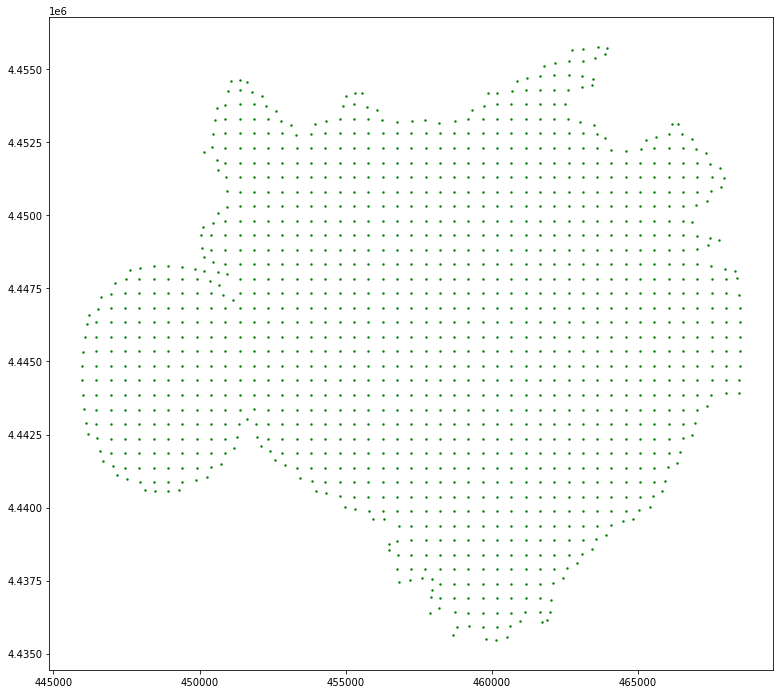

In [8]:
# quick plot of the centroids that will be interpreted as network nodes
fig, ax = plt.subplots(figsize=(20,12))
gdf.plot(ax=ax,color='green', markersize=2)
plt.show()

In [9]:
# create list containing ID pairs that will serve as origin and destination nodes in the OD networks
from tqdm import tqdm
pairs = []
for pair in tqdm(list(zip(flows_pos.origins, flows_pos.destinations))):
    pairs.append(pair)
    
print(pairs[:10])

100%|██████████████████████████████████████████████████████████████████████| 51427/51427 [00:00<00:00, 396854.01it/s]


[(0, 0), (0, 46), (0, 69), (0, 70), (0, 71), (0, 183), (0, 210), (0, 332), (0, 359), (0, 465)]


In [10]:
# create dataframe with the OD pairs as lines
df = pd.DataFrame(columns = ['origins','destinations','geometry'])
for pair in tqdm(pairs):
        
    geom0 = gdf.loc[pair[0]]['geometry']
    geom1 = gdf.loc[pair[1]]['geometry']

    start, end = [(geom0.x, geom0.y), (geom1.x, geom1.y)]
    line = LineString([start, end])

    # Create a DataFrame to hold record
    data = {'origins': pair[0],
            'destinations': pair[1],
            'geometry': [line]}
    df_line = pd.DataFrame(data, columns = ['origins', 'destinations', 'geometry'])

    # Add record DataFrame of compiled records
    df = pd.concat([df, df_line])
        
df.head()

100%|██████████████████████████████████████████████████████████████████████████| 51427/51427 [14:27<00:00, 59.31it/s]


,origins,destinations,geometry
0,0,0,LINESTRING (451859.3164664118 4443361.21725679...
0,0,46,LINESTRING (451859.3164664118 4443361.21725679...
0,0,69,LINESTRING (451859.3164664118 4443361.21725679...
0,0,70,LINESTRING (451859.3164664118 4443361.21725679...
0,0,71,LINESTRING (451859.3164664118 4443361.21725679...


In [11]:
# convert it into a geodataframe
gdf_line = gpd.GeoDataFrame(df,crs=crs, geometry='geometry')
#project it into the epsg=3857 coordinate reference system used by contextily for plotting
gdf_line_proj = gdf_line.to_crs(epsg=3857)
gdf_line_proj.tail()

,origins,destinations,geometry
0,1297,1203,"LINESTRING (4938976.782 4889963.612, 4942610.9..."
0,1297,1204,"LINESTRING (4938976.782 4889963.612, 4942606.5..."
0,1297,1205,"LINESTRING (4938976.782 4889963.612, 4942602.1..."
0,1297,1222,"LINESTRING (4938976.782 4889963.612, 4941962.3..."
0,1297,1239,"LINESTRING (4938976.782 4889963.612, 4941322.4..."


In [12]:
# fix dataframe indices
gdf_line_proj.index = np.arange(len(gdf_line_proj))
gdf_line_proj.tail()

,origins,destinations,geometry
51422,1297,1203,"LINESTRING (4938976.782 4889963.612, 4942610.9..."
51423,1297,1204,"LINESTRING (4938976.782 4889963.612, 4942606.5..."
51424,1297,1205,"LINESTRING (4938976.782 4889963.612, 4942602.1..."
51425,1297,1222,"LINESTRING (4938976.782 4889963.612, 4941962.3..."
51426,1297,1239,"LINESTRING (4938976.782 4889963.612, 4941322.4..."


In [13]:
#project Yerevan into the epsg=3857 coordinate reference system used by contextily for plotting
yerevan_proj = polyframe.to_crs(epsg=3857)
yerevan_proj

,FID,geometry,center_lon,center_lat
0,0,"POLYGON ((4946303.951 4886158.980, 4946297.573...",451859.316466,4.443361e+06
1,1,"POLYGON ((4946139.864 4886508.258, 4946135.712...",451854.505994,4.443852e+06
2,2,"POLYGON ((4946135.712 4887160.385, 4946131.559...",451854.505994,4.444349e+06
3,3,"POLYGON ((4946131.559 4887812.555, 4946127.405...",451854.506002,4.444846e+06
4,4,"POLYGON ((4946127.405 4888464.767, 4946123.249...",451854.519265,4.445344e+06
...,...,...,...,...
1294,1294,"POLYGON ((4938460.000 4887760.323, 4938475.054...",445989.479491,4.444843e+06
1295,1295,"POLYGON ((4938503.584 4888412.870, 4938532.756...",446018.939673,4.445335e+06
1296,1296,"POLYGON ((4938608.513 4889065.901, 4938628.307...",446072.501027,4.445821e+06
1297,1297,"POLYGON ((4938784.536 4889719.483, 4938928.922...",446147.153074,4.446274e+06


### Now, we will compute the following network measures across the hours of the day:

* **Network degree assortativity** 

The assortativity coefficient, _r_, is the Pearson correlation coefficient of degree between pairs of linked nodes. Positive values of _r_ indicate a correlation between nodes of similar degree, while negative values indicate relationships between nodes of different degree. In general, _r_ lies between −1 and 1. When _r_ = 1, the network is said to have perfect assortative mixing patterns, when _r_ = 0 the network is non-assortative, while at _r_ = −1 the network is completely disassortative.

* **Network reciprocity**

Reciprocity measures the proportion of node pairs in the network that have directed edges in **both** directions between them.

* **Network clustering coefficient**

In graph theory, a clustering coefficient is a measure of the degree to which nodes in a graph tend to cluster together.
The **local clustering coefficient** $C_{i}$ for a vertex $v_{i}$ is then given by a proportion of the number of links between the vertices within its neighbourhood divided by the number of links that could possibly exist between them. For a directed graph, $e_{ij}$ is distinct from $e_{ji}$, and therefore for each neighbourhood $N_{i}$ there are $k_{i}(k_{i}-1)$ links that could exist among the vertices within the neighbourhood ($k_{i}$ is the number of neighbours of a vertex). Thus, the **local clustering coefficient** for directed graphs is thus defined as:

$$
C_{i}=\frac{\left|\left\{e_{j k}: v_{j}, v_{k} \in N_{i}, e_{j k} \in E\right\}\right|}{k_{i}\left(k_{i}-1\right)} .
$$

As an overall measure of clustering in the network, we will use the average local clustering coefficient across all nodes:

$$
\bar{C}=\frac{1}{n} \sum_{i=1}^{n} C_{i} .
$$

* **Network transitivity**

Graph transitivity is the fraction of all possible triangles present in a graph. Possible triangles are identified by the number of “triads” (two edges with a shared vertex).
Transitivity is the overall probability for the network to have adjacent nodes interconnected, thus revealing the existence of tightly connected communities (or clusters, subgroups, cliques). It is calculated by the ratio between the observed number of closed triplets and the maximum possible number of closed triplets in the graph. Complex networks and notably small-world networks often have a high transitivity and a low diameter.

* **Network PageRank centrality rankings**  

Network centrality measures are used to identify the relative importance of nodes in a network. A particularly revealing centrality metric for urban mobility flow network is the PageRank centrality used by Google to rank its webpages. The idea behind it is very simple: a node is important if other important nodes are pointing at it. As we can notice it implies a self-referential system and mathematically satisfies the following equation:

$
x_{i}=\alpha \sum_{j} a_{j i} \frac{x_{j}}{L(j)}+\frac{1-\alpha}{N}
$

where $L(j)=\sum_{i} a_{j i}$ is the number of neighbors of node $j$ (or number of outbound links in a directed graph).

#### Once we compute all these network statistics for each hour of the day, we will plot them along with the network, creating an animated visualisation across the different hours of the day.

  0%|                                                                                         | 0/24 [00:00<?, ?it/s]



-----------  HOUR 1  -----------


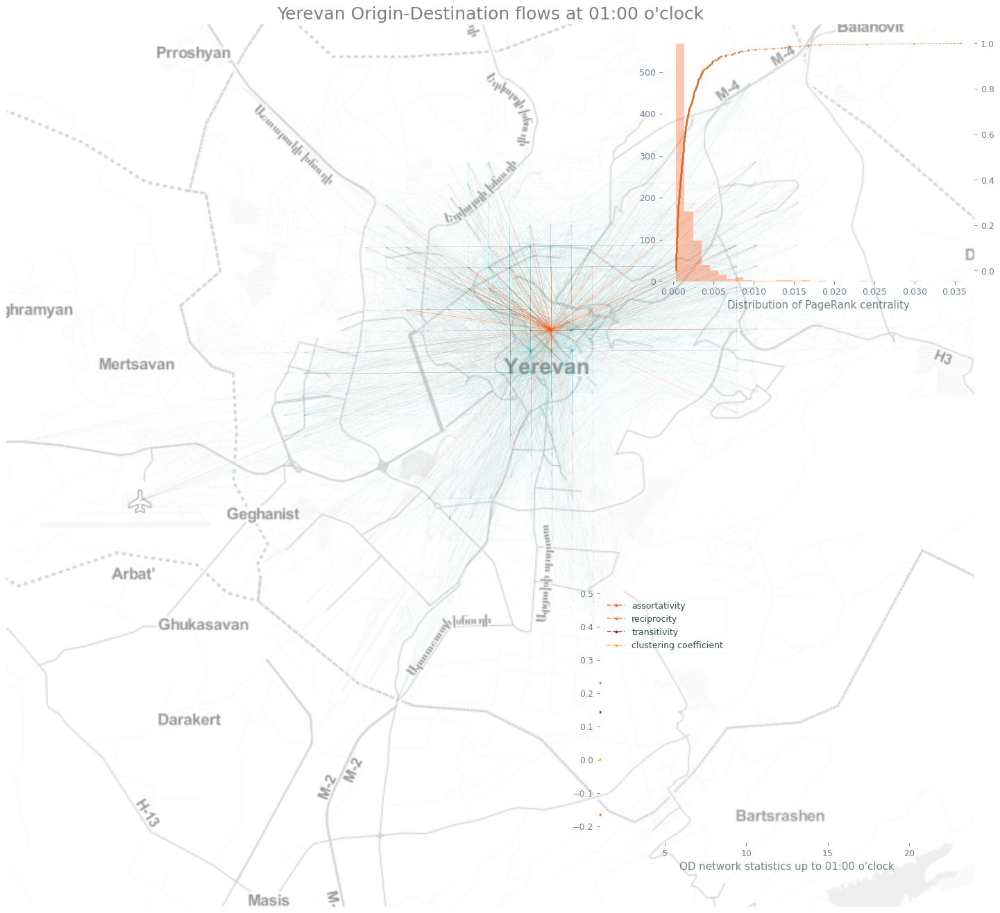

  4%|███▍                                                                             | 1/24 [00:16<06:14, 16.30s/it]



-----------  HOUR 2  -----------


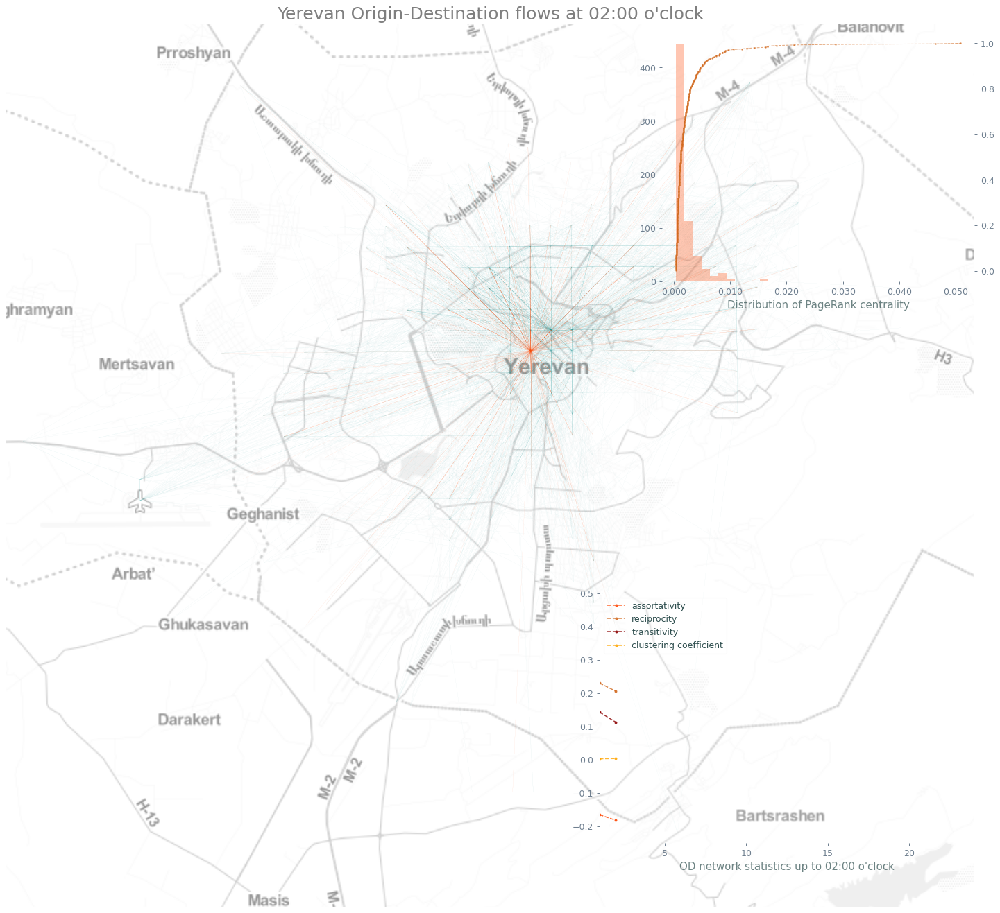

  8%|██████▊                                                                          | 2/24 [00:23<04:58, 13.57s/it]



-----------  HOUR 3  -----------


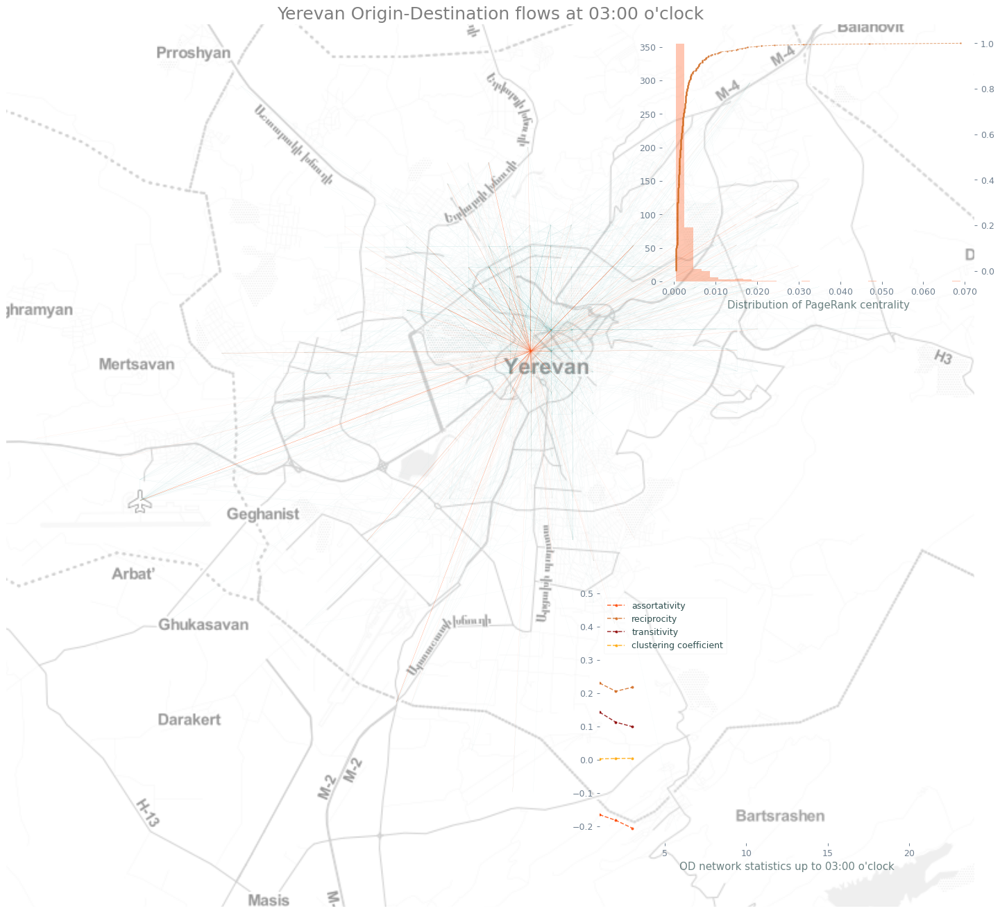

 12%|██████████▏                                                                      | 3/24 [00:30<04:00, 11.46s/it]



-----------  HOUR 4  -----------


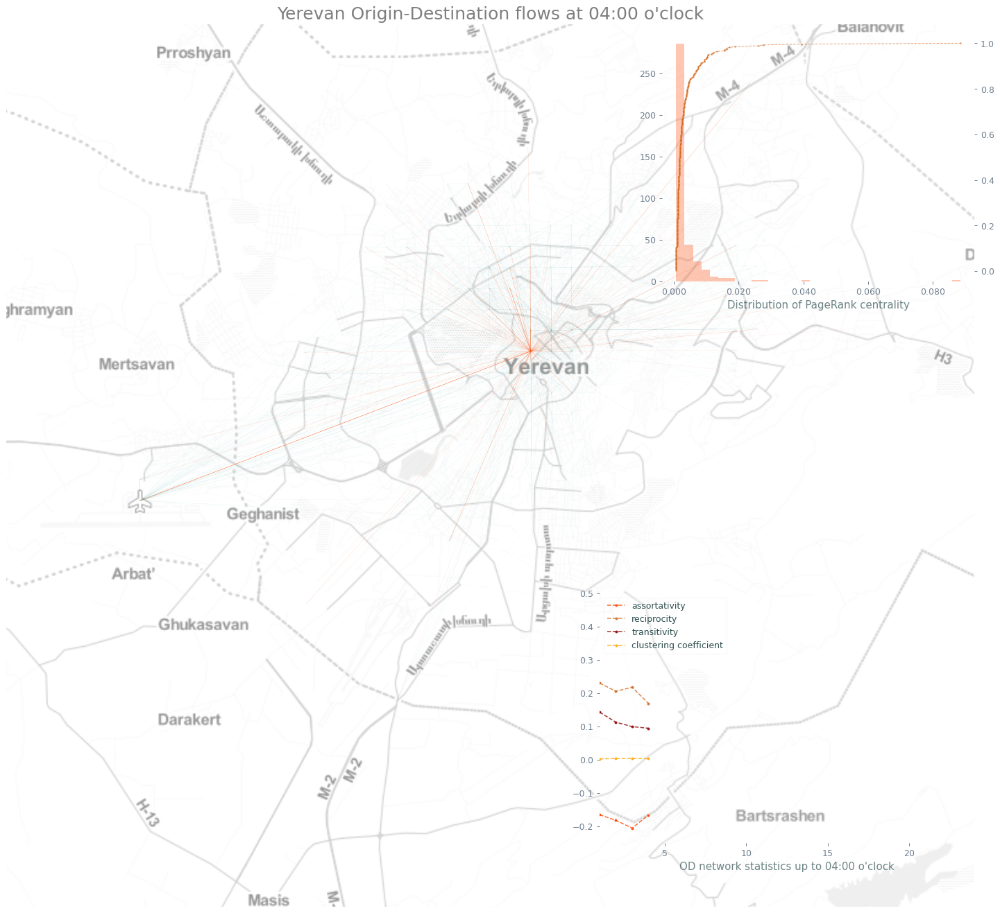

 17%|█████████████▌                                                                   | 4/24 [00:36<03:16,  9.83s/it]



-----------  HOUR 5  -----------


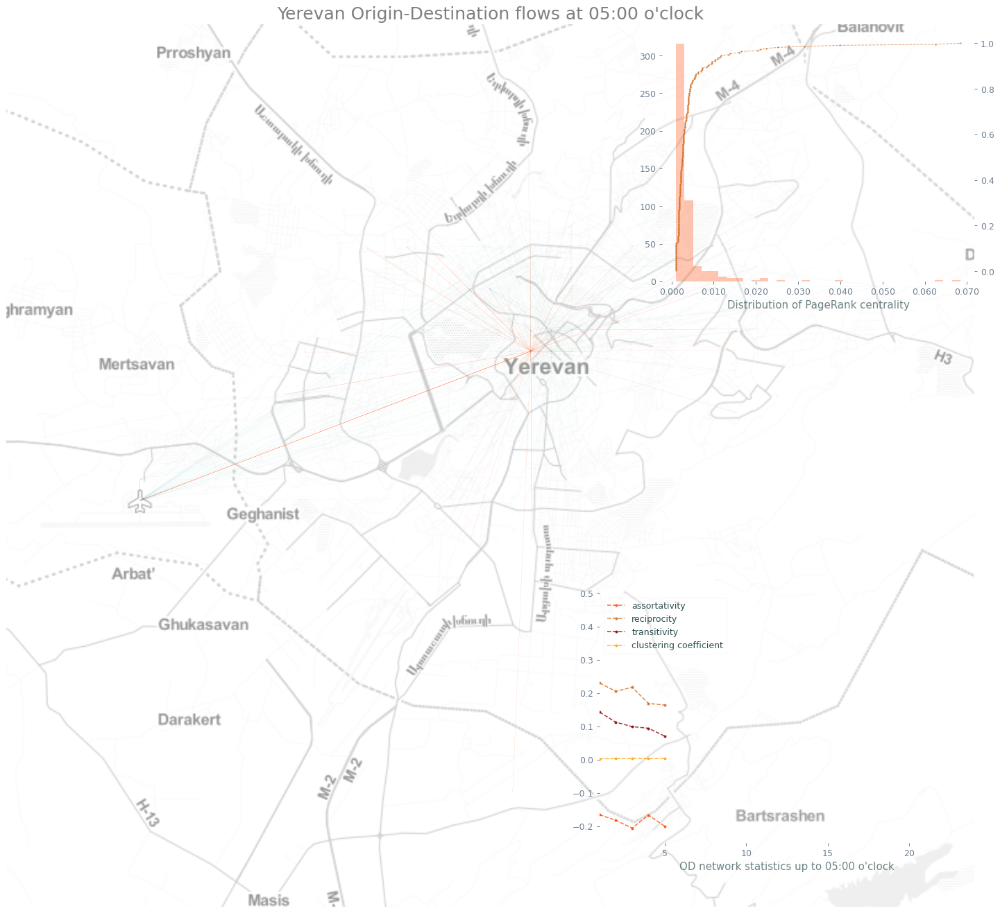

 21%|████████████████▉                                                                | 5/24 [00:41<02:43,  8.61s/it]



-----------  HOUR 6  -----------


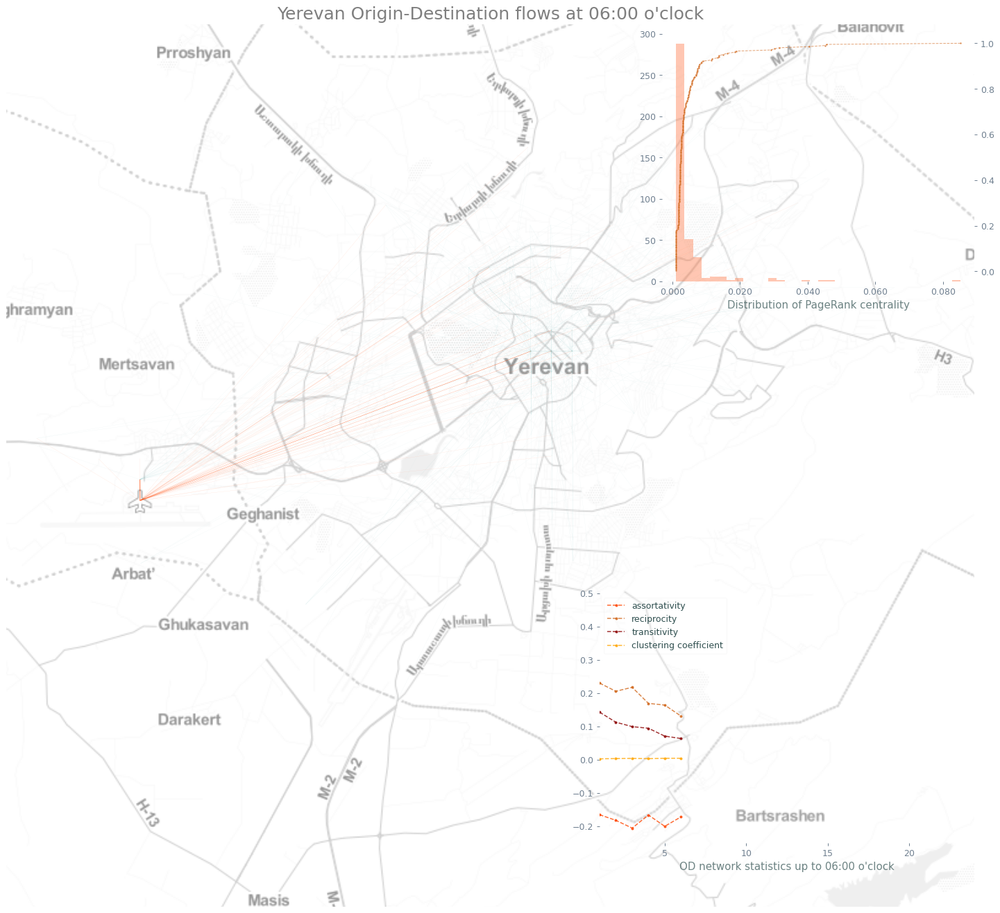

 25%|████████████████████▎                                                            | 6/24 [00:47<02:18,  7.68s/it]



-----------  HOUR 7  -----------


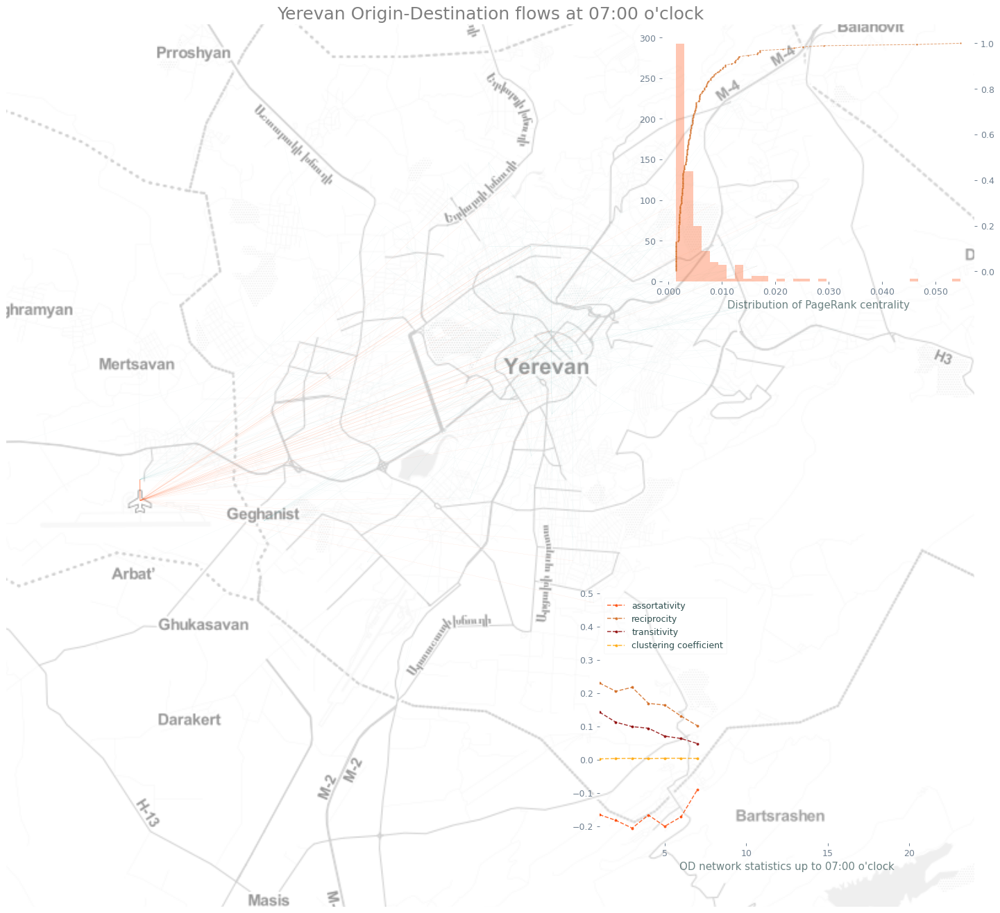

 29%|███████████████████████▋                                                         | 7/24 [00:52<01:58,  7.00s/it]



-----------  HOUR 8  -----------


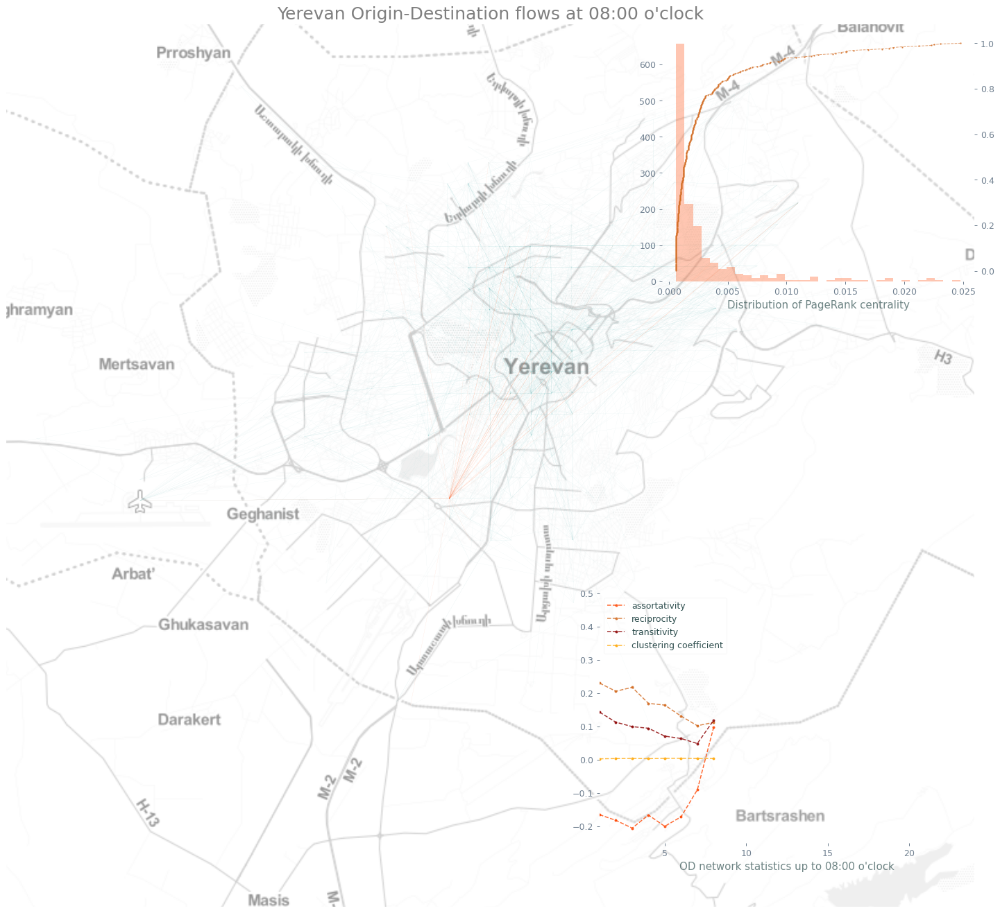

 33%|███████████████████████████                                                      | 8/24 [00:58<01:47,  6.73s/it]



-----------  HOUR 9  -----------


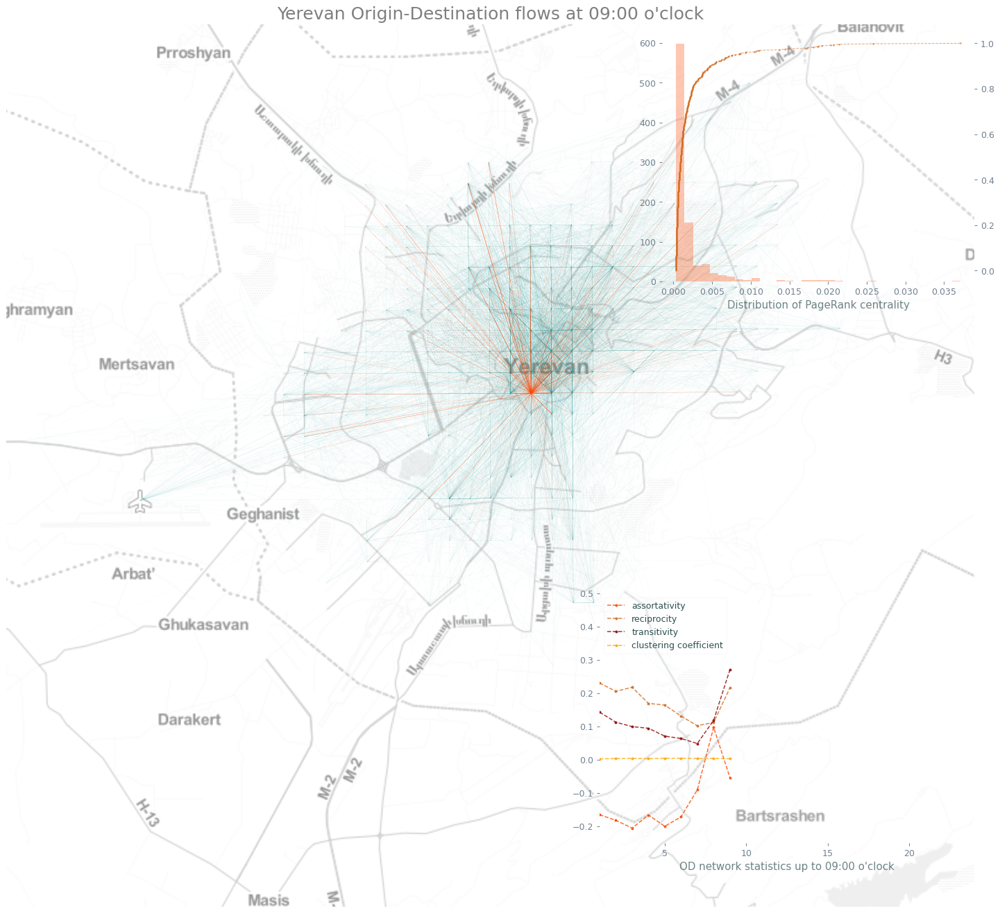

 38%|██████████████████████████████▍                                                  | 9/24 [01:09<01:56,  7.80s/it]



-----------  HOUR 10  -----------


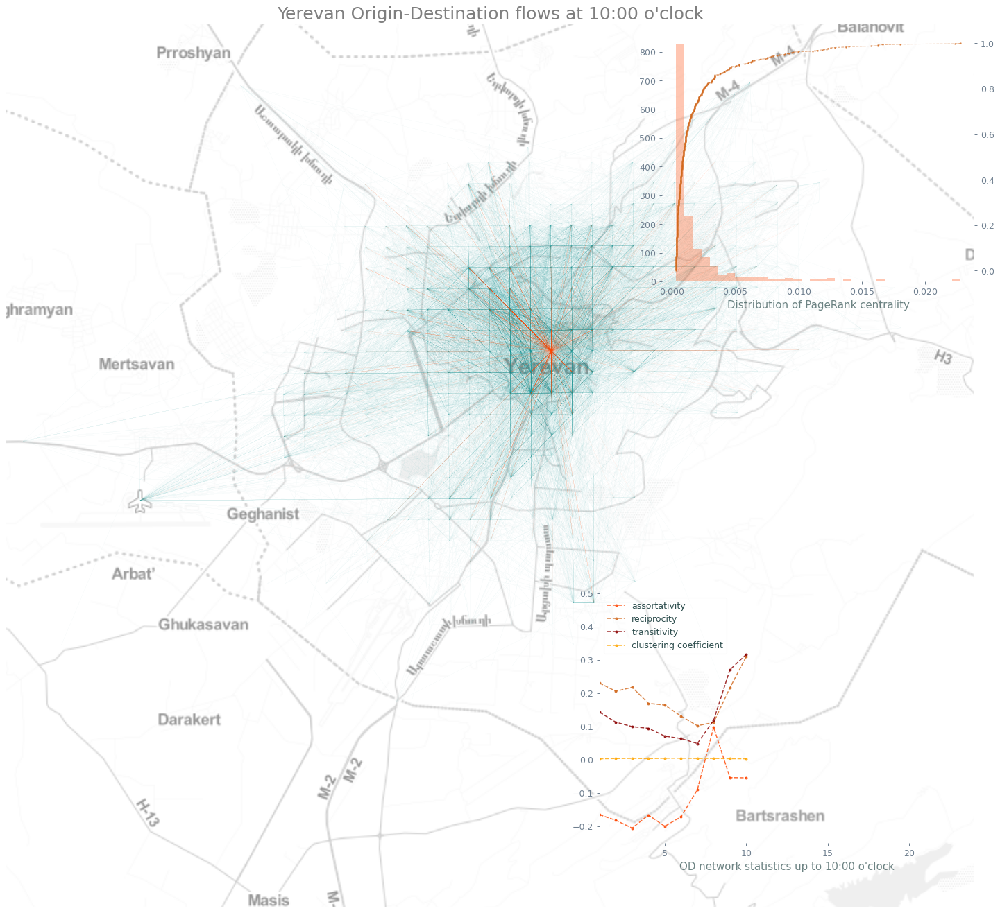

 42%|█████████████████████████████████▎                                              | 10/24 [01:24<02:21, 10.09s/it]



-----------  HOUR 11  -----------


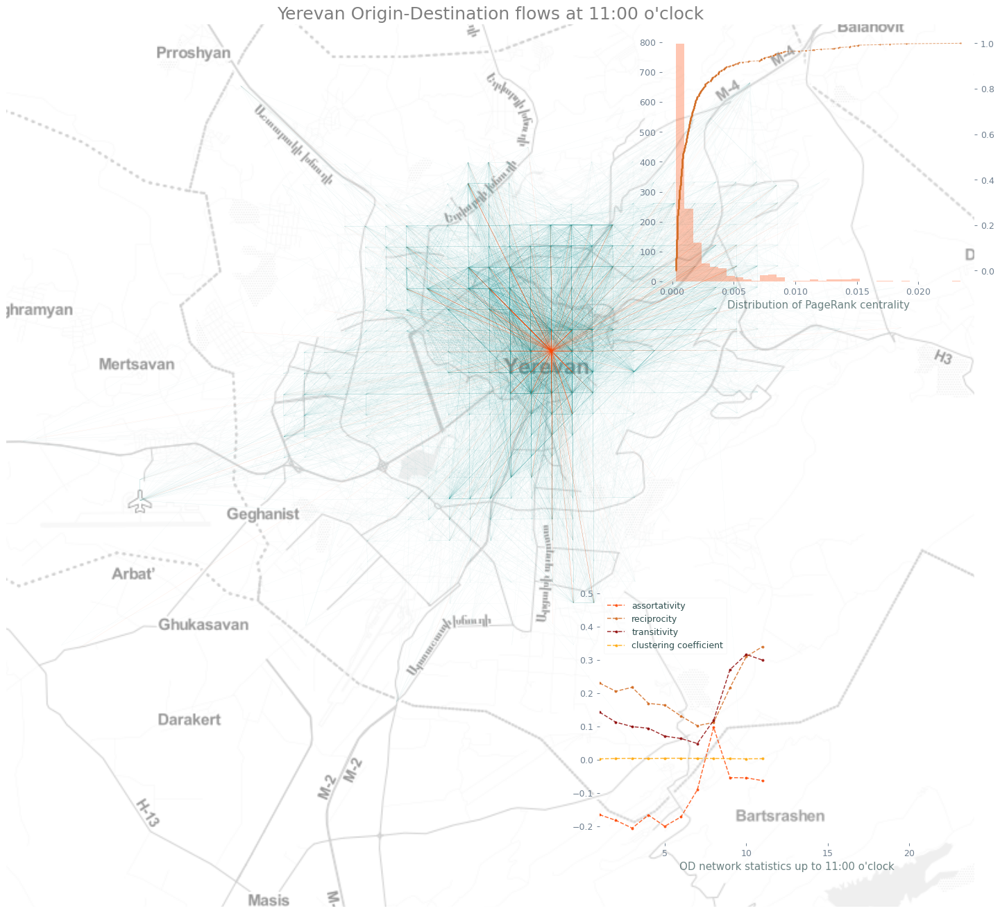

 46%|████████████████████████████████████▋                                           | 11/24 [01:40<02:34, 11.91s/it]



-----------  HOUR 12  -----------


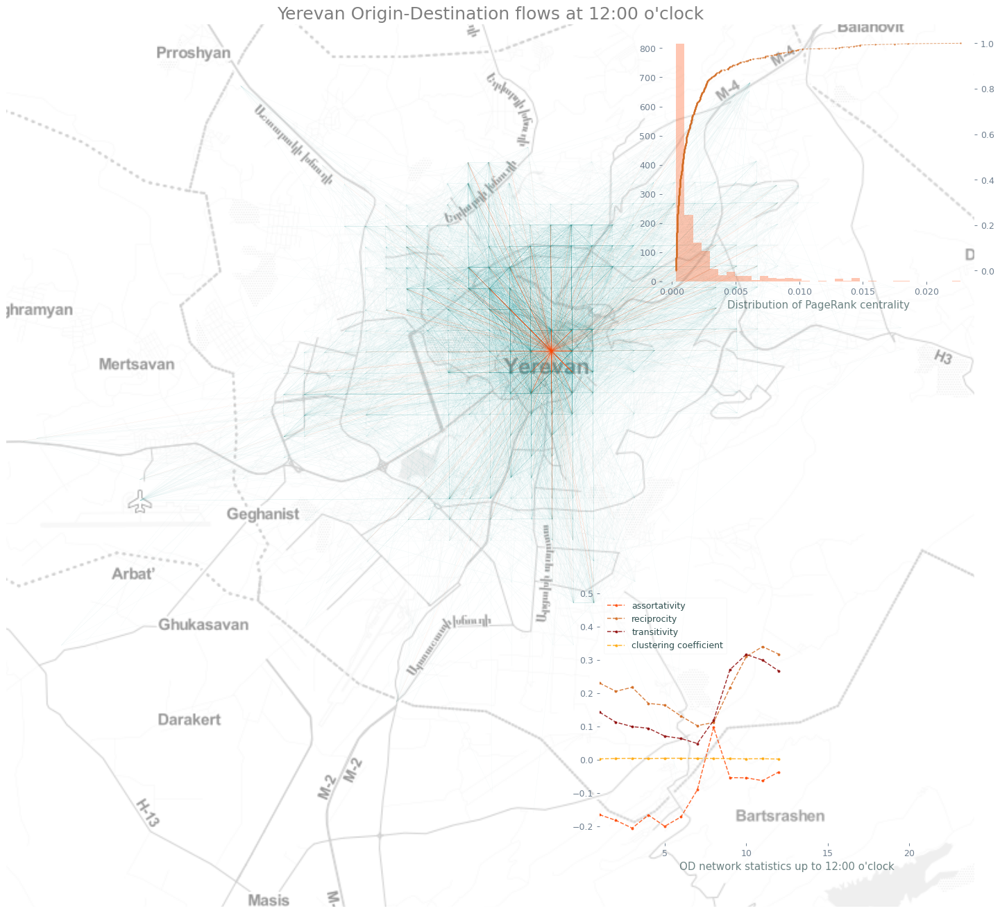

 50%|████████████████████████████████████████                                        | 12/24 [01:54<02:28, 12.41s/it]



-----------  HOUR 13  -----------


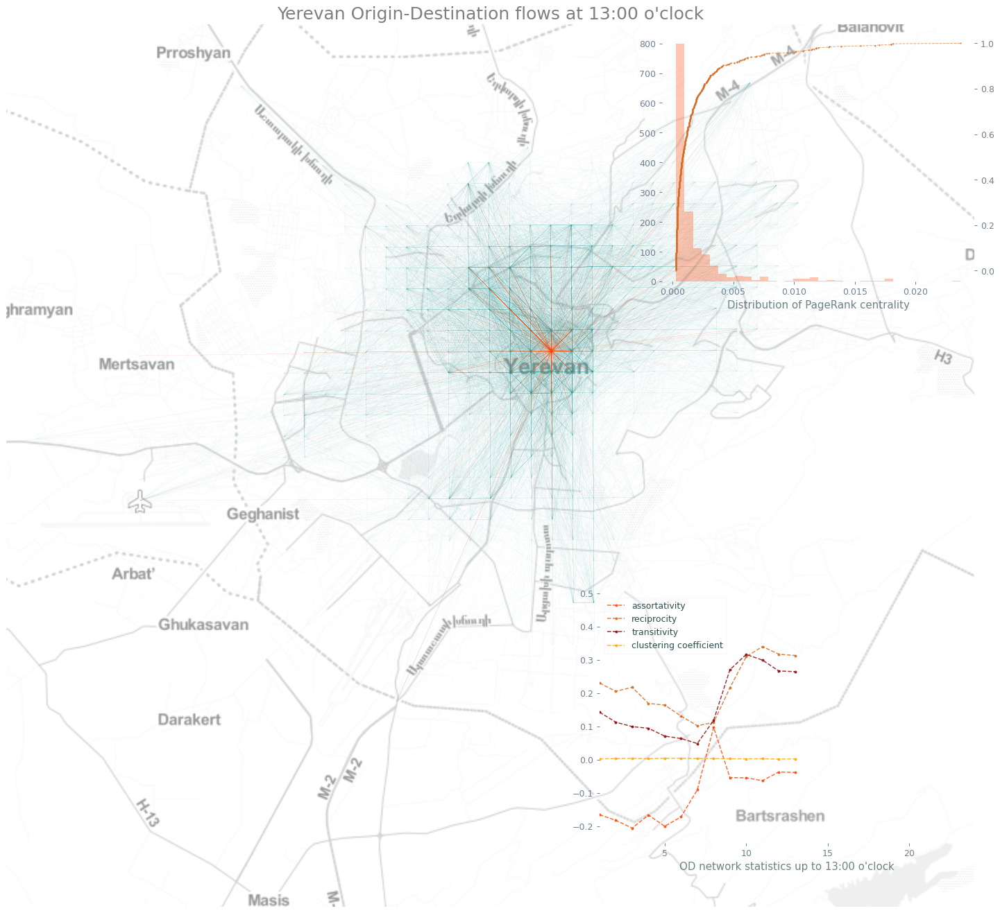

 54%|███████████████████████████████████████████▎                                    | 13/24 [02:07<02:19, 12.71s/it]



-----------  HOUR 14  -----------


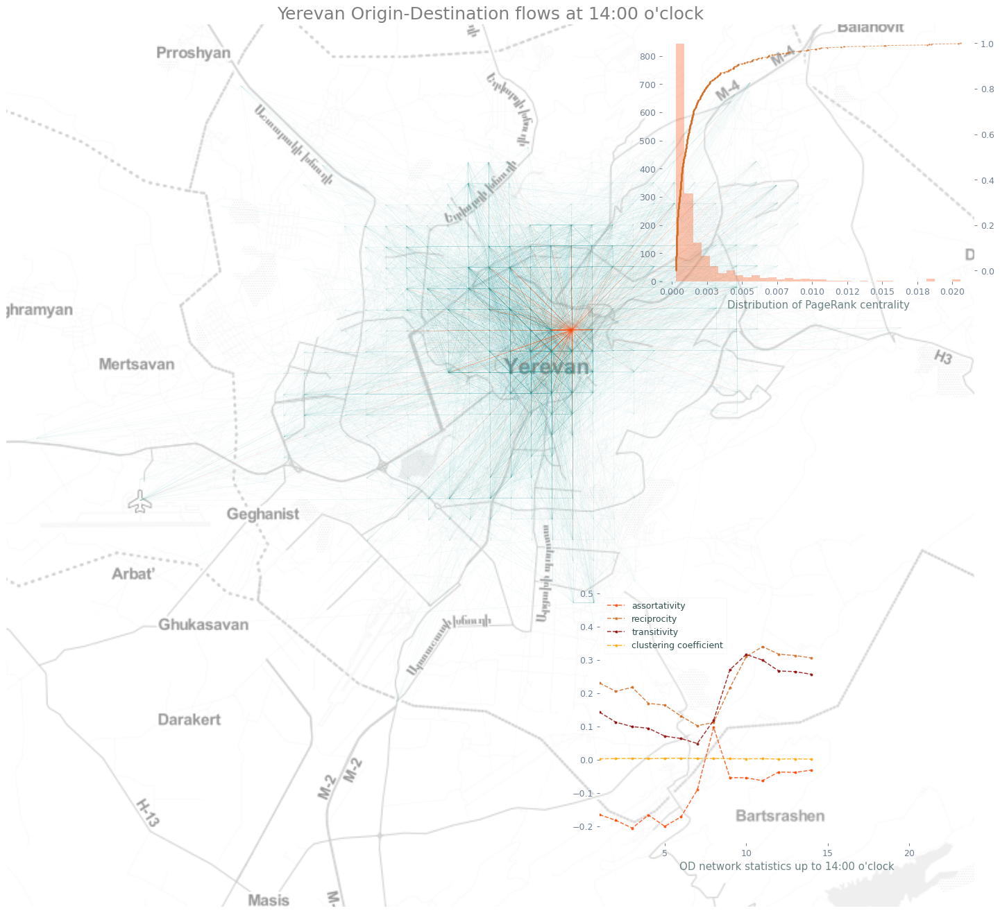

 58%|██████████████████████████████████████████████▋                                 | 14/24 [02:21<02:09, 12.93s/it]



-----------  HOUR 15  -----------


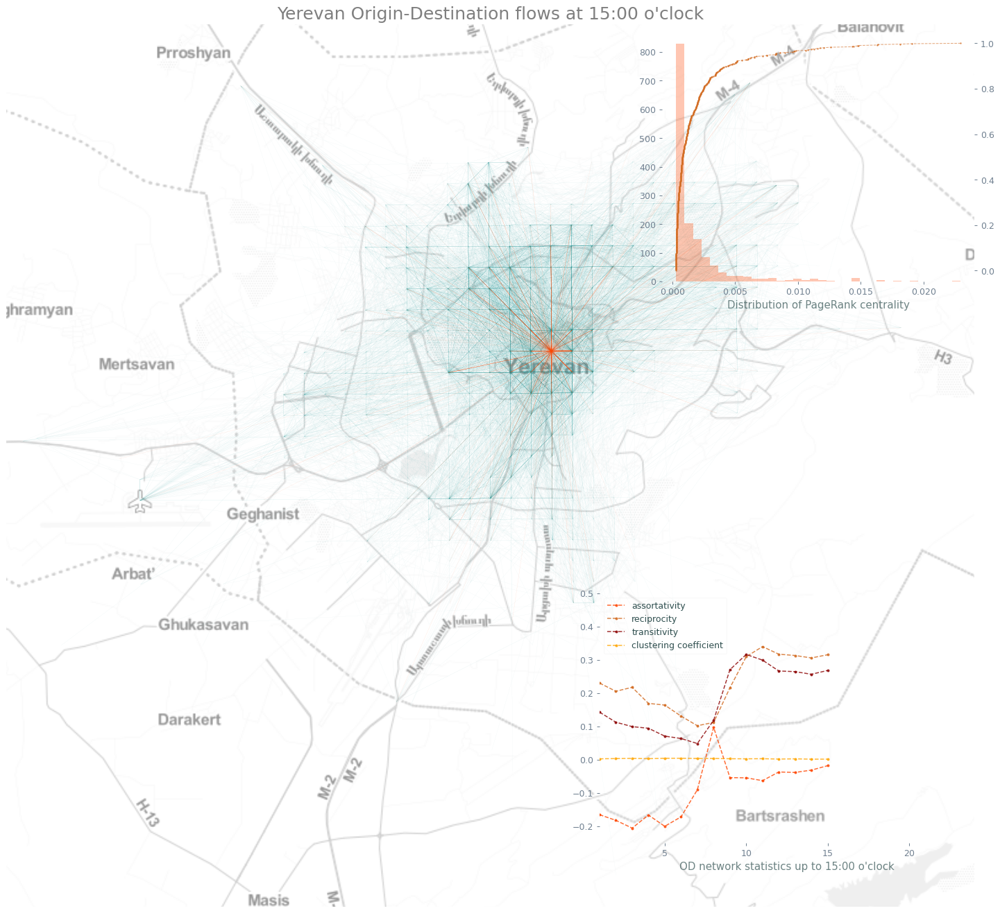

 62%|██████████████████████████████████████████████████                              | 15/24 [02:35<01:59, 13.25s/it]



-----------  HOUR 16  -----------


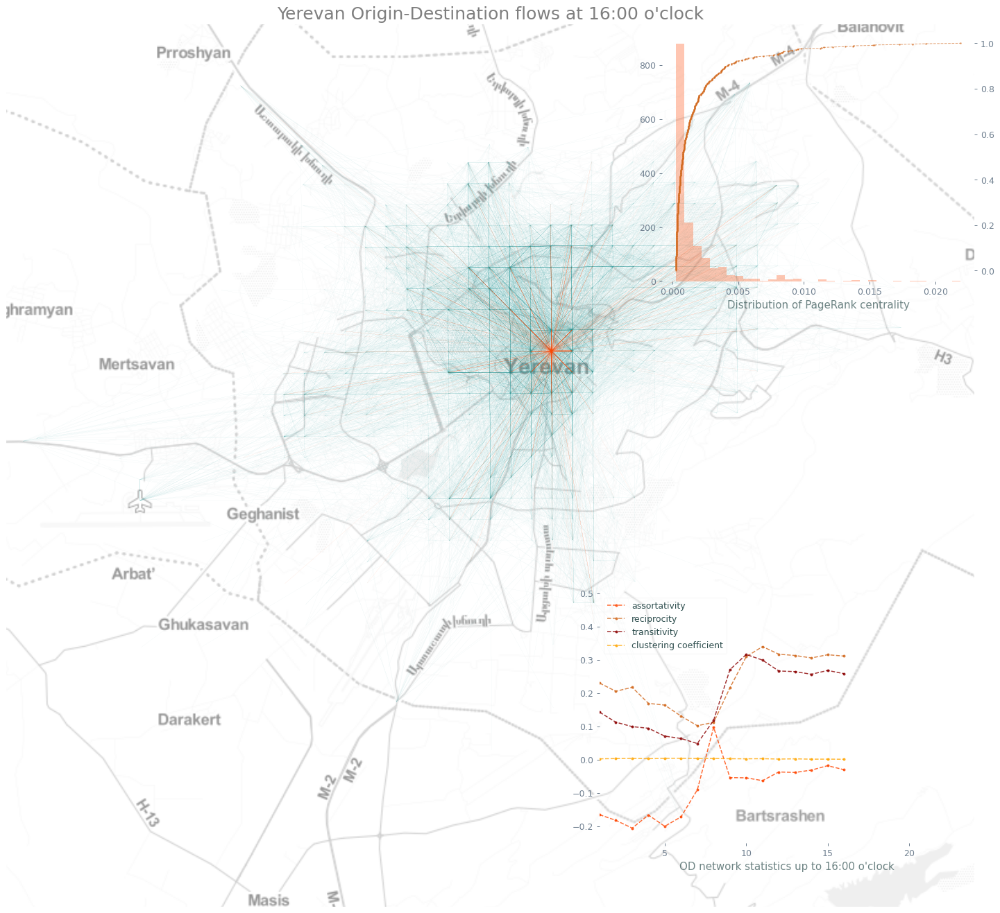

 67%|█████████████████████████████████████████████████████▎                          | 16/24 [02:49<01:48, 13.62s/it]



-----------  HOUR 17  -----------


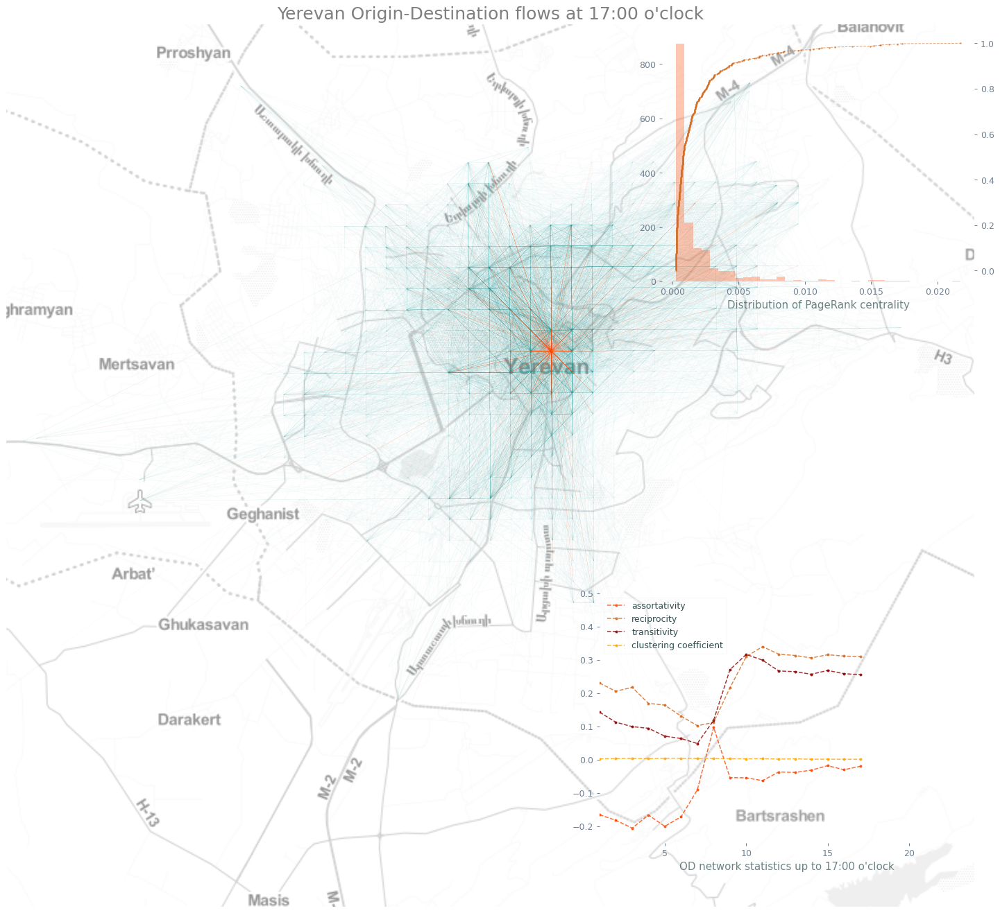

 71%|████████████████████████████████████████████████████████▋                       | 17/24 [03:03<01:36, 13.85s/it]



-----------  HOUR 18  -----------


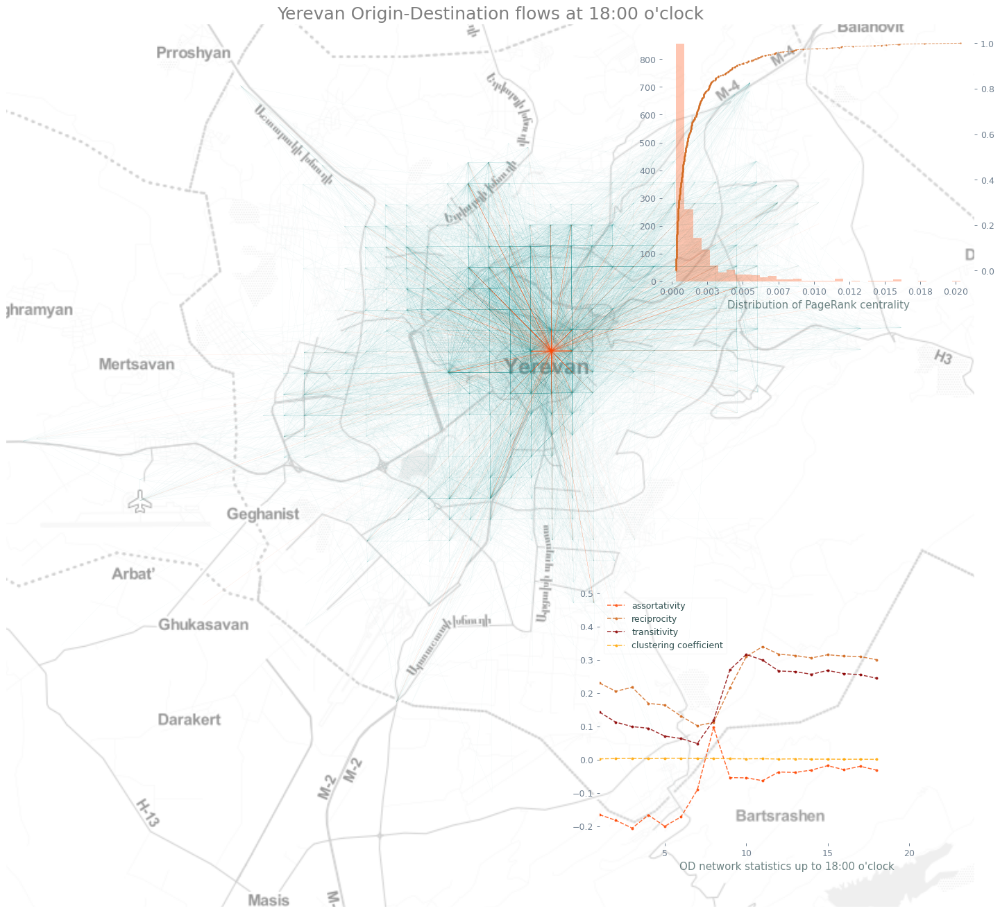

 75%|████████████████████████████████████████████████████████████                    | 18/24 [03:19<01:26, 14.44s/it]



-----------  HOUR 19  -----------


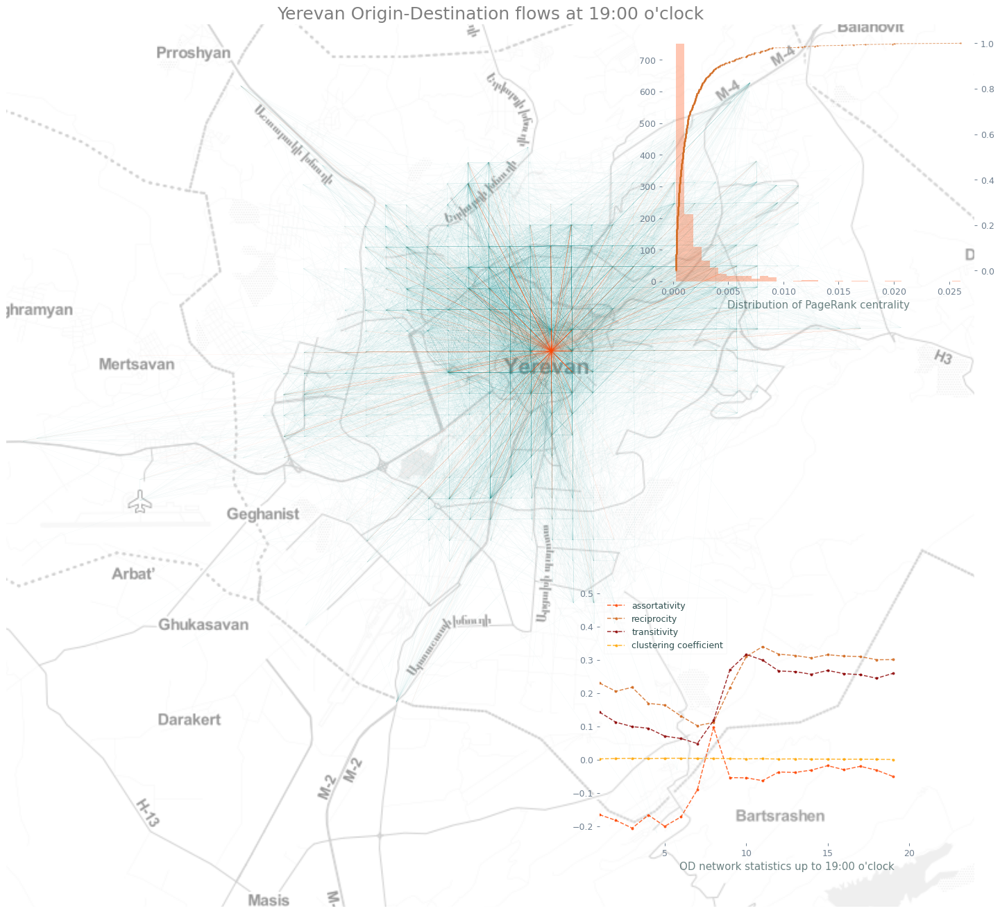

 79%|███████████████████████████████████████████████████████████████▎                | 19/24 [03:36<01:15, 15.19s/it]



-----------  HOUR 20  -----------


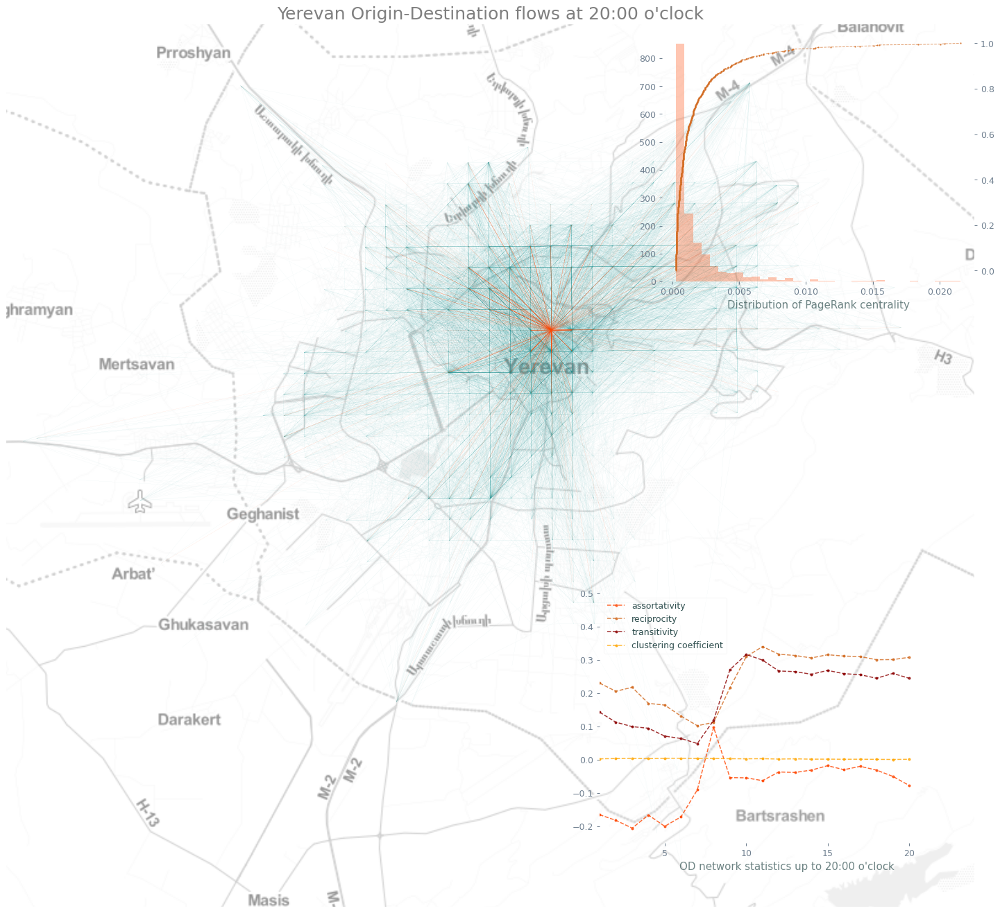

 83%|██████████████████████████████████████████████████████████████████▋             | 20/24 [03:52<01:01, 15.49s/it]



-----------  HOUR 21  -----------


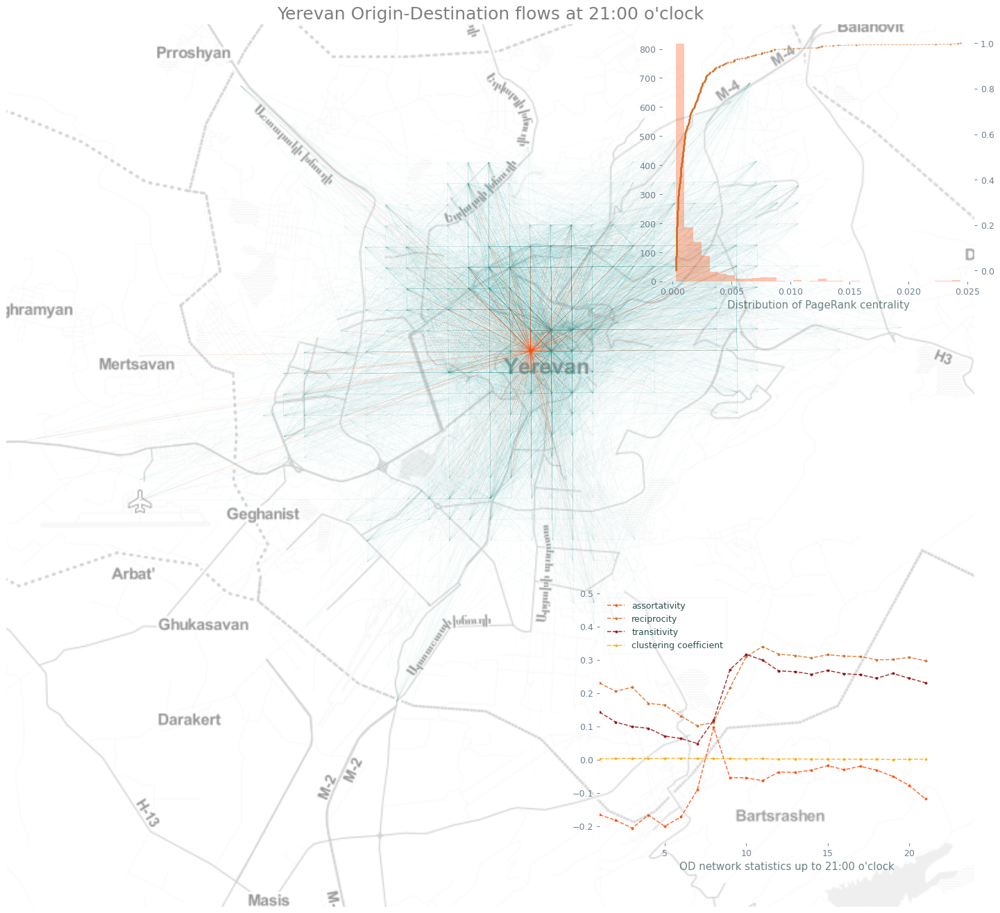

 88%|██████████████████████████████████████████████████████████████████████          | 21/24 [04:07<00:45, 15.32s/it]



-----------  HOUR 22  -----------


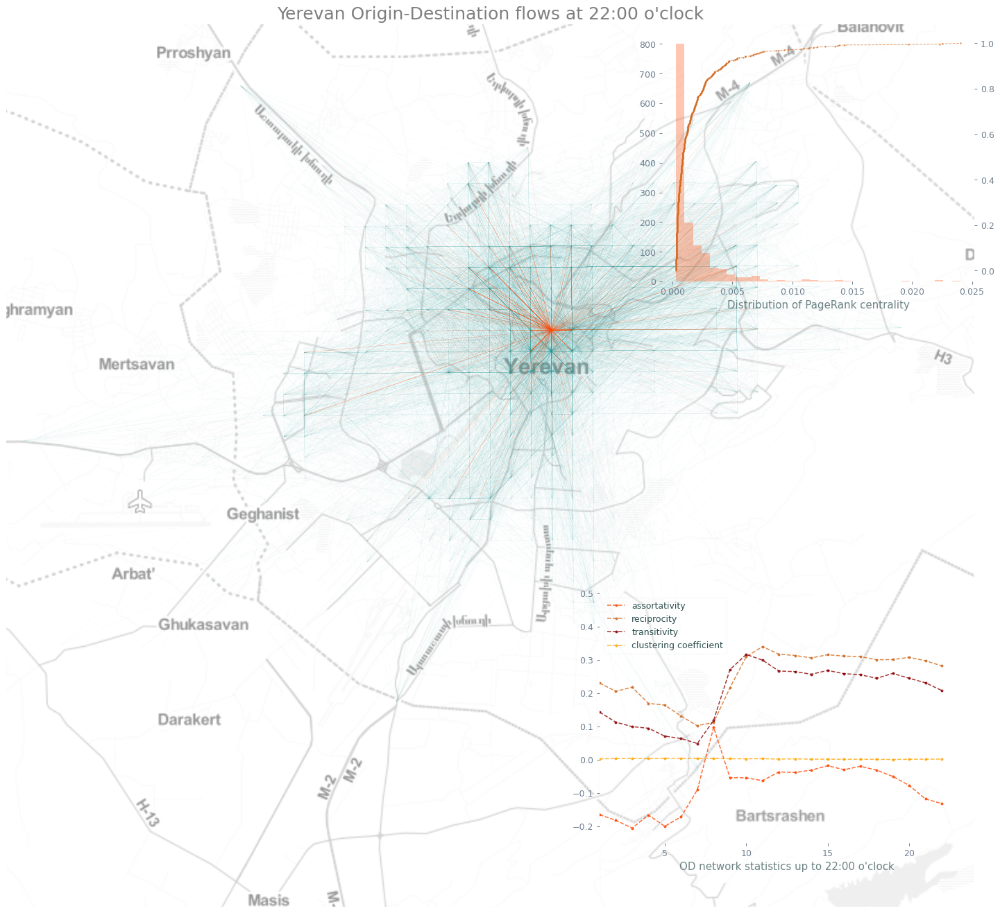

 92%|█████████████████████████████████████████████████████████████████████████▎      | 22/24 [04:21<00:29, 14.80s/it]



-----------  HOUR 23  -----------


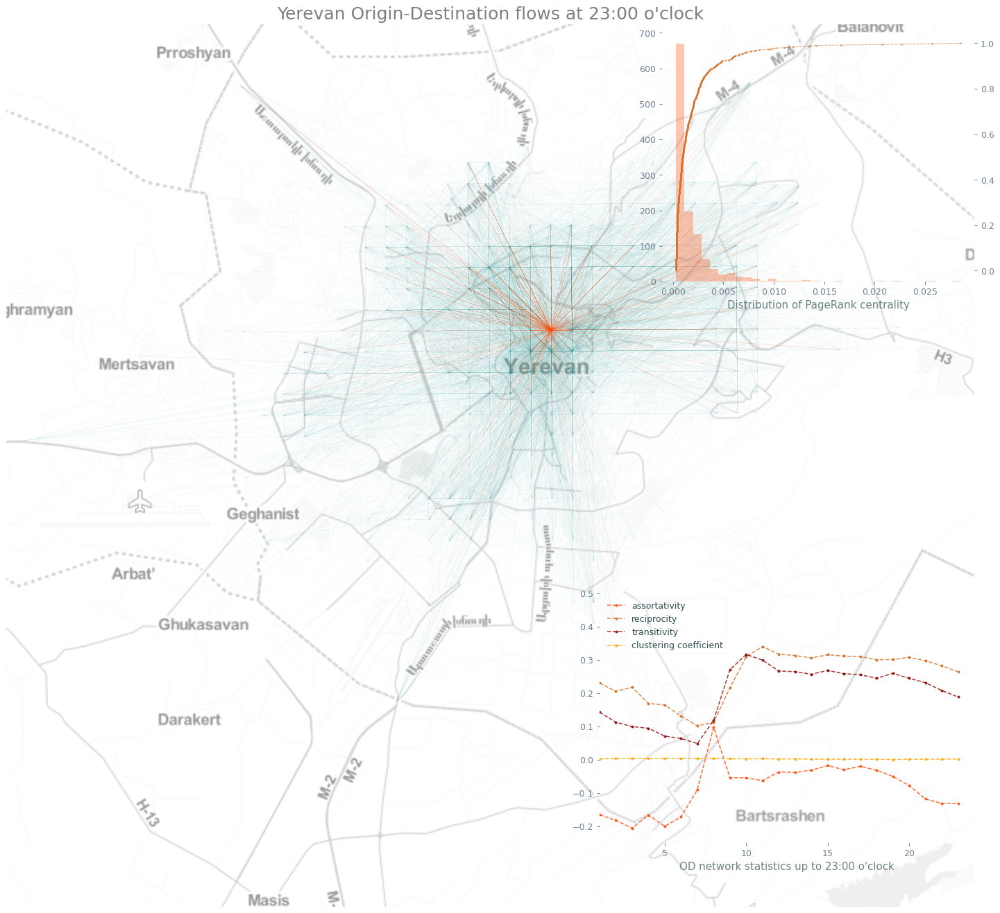

 96%|████████████████████████████████████████████████████████████████████████████▋   | 23/24 [04:33<00:14, 14.04s/it]



-----------  HOUR 24  -----------


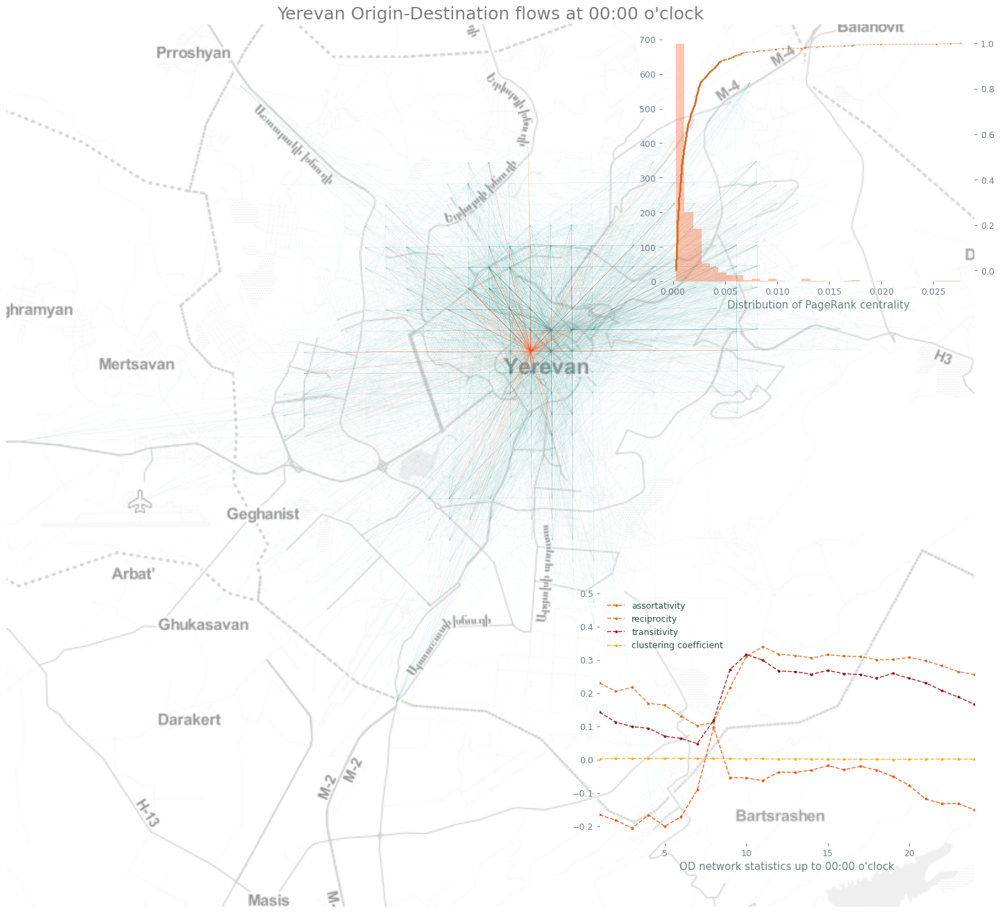

100%|████████████████████████████████████████████████████████████████████████████████| 24/24 [04:47<00:00, 12.00s/it]


In [15]:
import contextily as ctx
from matplotlib.ticker import FormatStrFormatter
from statsmodels.distributions.empirical_distribution import ECDF

# initiallise empty lists where we will store the computed network statistics
assortativities=[]
reciprocities=[]
clusterings = []
transitivities = []

# set up boundaries for plotting
west, south, east, north = yerevan_proj.unary_union.bounds

# start looping over the hours of the day
for hour in tqdm(range(1,25)):
    hours = np.arange(1,hour+1)
    print('\n')
    print('-----------  HOUR {}  -----------'.format(hour))
    
    # extract a dataframe containing the flows for the given hour and store it in a variable called lines denoting the edges
    lines = flows_pos[['origins', 'destinations', 'hour_{}'.format(hour)]]
    # rename the columns to match the parameter names required by networkx for transforming our dataframe into a networkx graph object
    lines.columns = ["source", "target", "weight"]
    # keep only edges with a positive flow
    lines = lines[lines.weight>0]
    sources = lines.source.unique()
    targets = lines.target.unique()
    
    # create the mobility network for the given hour
    G = nx.DiGraph((row['source'], row['target'], {'weight': row['weight']}) for index, row in lines.iterrows())
    # compute the PageRank as a dictionary
    pagerank_dict = nx.pagerank(G, weight='weight')
    # create sorted list containing the PageRank values of the nodes in descending order and pick the highest
    s = [(k, pagerank_dict[k]) for k in sorted(pagerank_dict, key=pagerank_dict.get)]
    s = s[::-1]
    # find index of the node with the highest centrality 
    max_deg_index = [p[0] for p in s[:1]]

    # set up and assign the flows for a given hour as a weight column in the network edges geodataframe
    gdf_line_proj['weight'] = 0 
    gdf_line_proj['weight'].update(flows_pos['hour_{}'.format(hour)])
    # slice and extract the edges connected to the most central node as a separate dataframe
    l_node = gdf_line_proj[(gdf_line_proj.origins.isin(max_deg_index)) | (gdf_line_proj.destinations.isin(max_deg_index))]
    # store the remaining edges in a different dataframe
    l_rest = gdf_line_proj[(~gdf_line_proj.origins.isin(max_deg_index))&(~gdf_line_proj.destinations.isin(max_deg_index))]
    

    # start plotting
    fig, ax = plt.subplots(figsize=(20,20), dpi=90)

    
    l_rest.plot(ax=ax,color='darkcyan', linewidth=85*l_rest.weight/flows_pos.total_flow.max(), alpha=0.4, zorder=2)
    l_node.plot(ax=ax,color='orangered', linewidth=140*l_node.weight/flows_pos.total_flow.max(), alpha=0.65, zorder=3)
    # add basemap
    ctx.add_basemap(ax,source=ctx.providers.Stamen.TonerLite, attribution="", zoom='auto', alpha=0.4)    
    ax.set_xlim(west, east)
    ax.set_ylim(south, north)
    ax.axis('off')
    
    
    # compute the four network statistics and append them to their respective lists
    reciprocities.append(nx.algorithms.reciprocity(G))
    assortativities.append(nx.algorithms.degree_assortativity_coefficient(G))
    clusterings.append(nx.algorithms.cluster.average_clustering(G, weight='weight'))
    transitivities.append(nx.algorithms.cluster.transitivity(G))
    
    # compute the empirical cumulative distribution of the pagerank values
    ecdf = ECDF(list(pagerank_dict.values()))
    # this is an inset axes over the main axes
    right_inset_ax = fig.add_axes([.65, .65, .25, .2])
    right_inset_ax.patch.set_alpha(0.1)
    right_inset_ax1 = right_inset_ax.twinx()
    right_inset_ax.hist(pagerank_dict.values(),bins=34, alpha=0.3, color='orangered', density=True)
    
    right_inset_ax1.plot(ecdf.x,ecdf.y, color='chocolate', linestyle='--', marker='o', markersize=1, linewidth=0.8, alpha=0.6)
    right_inset_ax.xaxis.set_major_formatter(FormatStrFormatter('%.3f'))

    right_inset_ax.tick_params(axis='x', colors='slategrey')
    right_inset_ax.tick_params(axis='y', colors='slategrey')
    right_inset_ax1.tick_params(axis='y', colors='slategrey')
    right_inset_ax.spines['right'].set_visible(False)
    right_inset_ax.spines['top'].set_visible(False)
    right_inset_ax.spines['left'].set_visible(False)
    right_inset_ax.spines['bottom'].set_visible(False)
    right_inset_ax1.spines['right'].set_visible(False)
    right_inset_ax1.spines['top'].set_visible(False)
    right_inset_ax1.spines['left'].set_visible(False)
    right_inset_ax1.spines['bottom'].set_visible(False)
    right_inset_ax.set_xlabel('Distribution of PageRank centrality', fontsize= 12, alpha=0.7, color='darkslategrey')

    
    #this is another inset axes over the main axes
    left_inset_ax = fig.add_axes([.6, .2, .3, .2])
    left_inset_ax.patch.set_alpha(0.1)
    left_inset_ax.plot(hours, assortativities, color='orangered', linestyle='--', marker='o', markersize=2.2, linewidth=1.2, alpha=0.8, label='assortativity')
    left_inset_ax.plot(hours, reciprocities, color='chocolate', linestyle='--', marker='o', markersize=2.2, linewidth=1.2, alpha=0.8, label='reciprocity')
    left_inset_ax.plot(hours, transitivities, color='darkred', linestyle='--', marker='o', markersize=2.2, linewidth=1.2, alpha=0.8, label='transitivity')
    left_inset_ax.plot(hours, clusterings, color='orange', linestyle='--', marker='o', markersize=2.2, linewidth=1.2, alpha=0.8, label='clustering coefficient')
    
    left_inset_ax.set_xlim(1, 24)
    left_inset_ax.set_ylim(-0.25, 0.5)

#     # Hide the right and top spines
    left_inset_ax.spines['right'].set_visible(False)
    left_inset_ax.spines['top'].set_visible(False)
    left_inset_ax.spines['left'].set_visible(False)
    left_inset_ax.spines['bottom'].set_visible(False)
#     # Only show ticks on the left and bottom spines
    left_inset_ax.yaxis.set_ticks_position('left')
    left_inset_ax.tick_params(axis='x', colors='slategrey')
    left_inset_ax.tick_params(axis='y', colors='slategrey')
    leg = left_inset_ax.legend(loc=2,fancybox=True, prop={'size': 10}, framealpha=0.1)
    for text in leg.get_texts():
        plt.setp(text, color = 'darkslategrey')

    left_inset_ax.set_xlabel("OD network statistics up to {}:00 o'clock".format(hour%24 if hour%24>9 else '0'+ str(hour%24)), fontsize= 12, alpha=0.7, color='darkslategrey')
    ax.set_title("Yerevan Origin-Destination flows at {}:00 o'clock".format(hour%24 if hour%24>9 else '0'+ str(hour%24)),fontsize= 20, alpha=0.5)
    #plt.tight_layout()
    fig.savefig('OD/OD_{}.png'.format(hour%24 if hour%24>9 else '0'+ str(hour%24)), dpi=fig.dpi)
    plt.show()

Text(0.5, 1.0, 'Urban mobility OD network statistics')

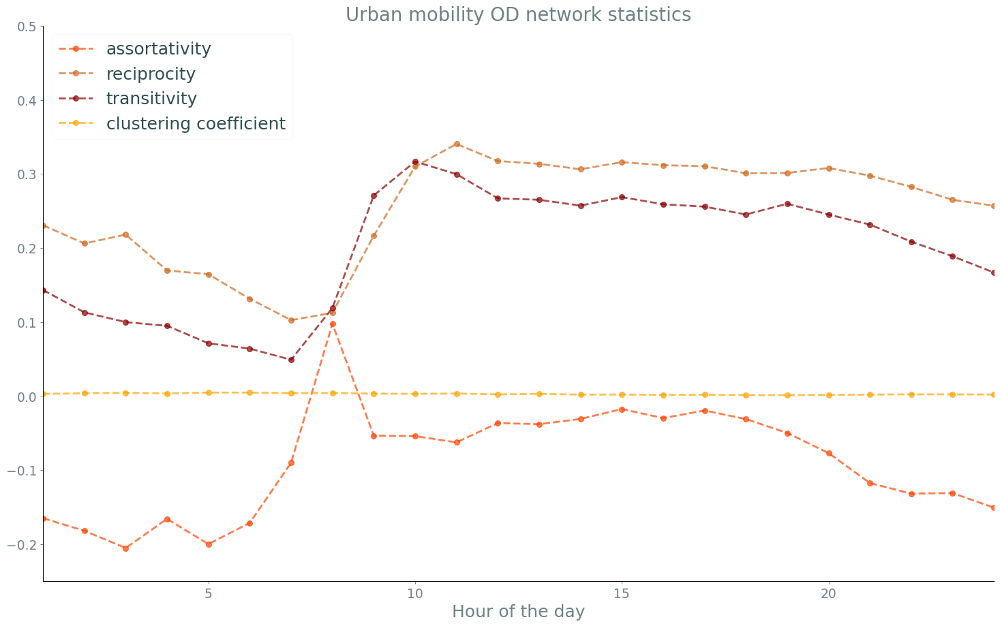

In [16]:
fig, ax = plt.subplots(figsize=(20,12), dpi=90)
ax.patch.set_alpha(0.1)
ax.plot(hours, assortativities, color='orangered', linestyle='--', marker='o', markersize=6.2, linewidth=2.2, alpha=0.7, label='assortativity')
ax.plot(hours, reciprocities, color='chocolate', linestyle='--', marker='o', markersize=6.2, linewidth=2.2, alpha=0.7, label='reciprocity')
ax.plot(hours, transitivities, color='darkred', linestyle='--', marker='o', markersize=6.2, linewidth=2.2, alpha=0.7, label='transitivity')
ax.plot(hours, clusterings, color='orange', linestyle='--', marker='o', markersize=6.2, linewidth=2.2, alpha=0.7, label='clustering coefficient')

ax.set_xlim(1, 24)
ax.set_ylim(-0.25, 0.5)

#     # Hide the right and top spines
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(True)
ax.spines['bottom'].set_visible(True)
#     # Only show ticks on the left and bottom spines
ax.yaxis.set_ticks_position('left')
ax.tick_params(axis='x', colors='slategrey', labelsize=15)
ax.tick_params(axis='y', colors='slategrey', labelsize=15)
leg = ax.legend(loc=2,fancybox=True, prop={'size': 20}, framealpha=0.1)
for text in leg.get_texts():
    plt.setp(text, color = 'darkslategrey')

ax.set_xlabel("Hour of the day", fontsize= 20, alpha=0.7, color='darkslategrey')
ax.set_title("Urban mobility OD network statistics", fontsize= 22, alpha=0.7, color='darkslategrey')
#plt.savefig("OD_network_stats.jpg", dpi=fig.dpi)

In [17]:
import re
def sorted_nicely( l ):
    """ Sorts the given iterable in the way that is expected.
 
    Required arguments:
    l -- The iterable to be sorted.
 
    """
    convert = lambda text: int(text) if text.isdigit() else text
    alphanum_key = lambda key: [convert(c) for c in re.split('([0-9]+)', key)]
    return sorted(l, key = alphanum_key)

from os import listdir
filenames = listdir('OD/')
filenames = sorted_nicely(filenames)
filenames

['OD_00.png',
 'OD_01.png',
 'OD_02.png',
 'OD_03.png',
 'OD_04.png',
 'OD_05.png',
 'OD_06.png',
 'OD_07.png',
 'OD_08.png',
 'OD_09.png',
 'OD_10.png',
 'OD_11.png',
 'OD_12.png',
 'OD_13.png',
 'OD_14.png',
 'OD_15.png',
 'OD_16.png',
 'OD_17.png',
 'OD_18.png',
 'OD_19.png',
 'OD_20.png',
 'OD_21.png',
 'OD_22.png',
 'OD_23.png']

### Now let's create the final GIF animation

In [19]:
#!pip install imageio
# fps = frames per second to control for animation speed
import imageio
with imageio.get_writer('Yerevan_PageRank_anim.gif', mode='I',fps=8) as writer:
    for filename in tqdm(filenames):
        image = imageio.imread('OD/{}'.format(filename))
        writer.append_data(image)

100%|████████████████████████████████████████████████████████████████████████████████| 24/24 [00:13<00:00,  1.82it/s]


## Results

### So what can simple network measures tell us about urban mobility in the city?

* It is essentially disassortive during the late evening and night hours: places with high flow (e.g., Republic Square, the airport) tend to connect more with places with little flow in the periphery of the city. Inter-peripheric relationships are mostly absent. During the morning and afternoon, however, the assortativity coefficient tends to rise to positive values, meaning that most mobility flow is taking place between popular central locations in the city. This finding corresponds to existing findings in urban mobility [literature](https://www.nature.com/articles/ncomms7007) about mobility in monocentric cities. 

* It has low reciprocity: somewhere between just 5% to 25% of flows are going both ways at a given hour. 

* It has low transitivity (the fraction of all possible triangles present in a network) and an almost zero clustering coefficient (the average of the proportions of links in the nodes' neighbourhood relative to all possible links that could exist). This could mean that despite the presence of hubs, the urban flow network is not [small-world](https://en.wikipedia.org/wiki/Small-world_network#:~:text=A%20small%2Dworld%20network%20is,number%20of%20hops%20or%20steps.), has a more star-like structure, and as such non-robust to attacks and interventions.

* We reaffirm our observation that urban mobility is extremely unequally distributed across the city. This can be seen from the distribution of the PageRank centralities denoting the most central locations in the city. The vast majority of locations has a small centrality, while a few number of locations are responsible for a very large flow and thus have a very high centrality in the urban mobility network.